# Import

In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import sklearn
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
import shap


import os
for dirname, _, filenames in os.walk('/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))



/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/GDP_Cleaned.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/.DS_Store
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/WE_Index_Clean.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/11_13_2023_WEI.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/11_18_2023_WEI_CleanImputed.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/Child_Leave_Qs_Clean.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/Fifty_Year_Change_Clean.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/GDP_Clean.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/All_Questions_Clean.csv
/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/11_10_2023_WEI.csv


In [114]:
#import data and begin cleaning nulls
df = pd.read_csv('/Users/amritambe/Desktop/Analysis_Project/Women_Empowerment/2 Data/Clean_Data/11_13_2023_WEI.csv')
pd.set_option('display.max_rows', None)

df.columns, df.isna().sum()

(Index(['Unnamed: 0', 'Country_Name', 'Year', 'GDP_Growth', 'Index_1971',
        'Index_2020', 'Fifty_Year_Change', 'Region', 'Income_Group',
        'Question_Category', 'Question', 'Index_Score', '2020_Data_Rank',
        '2020_1GB_Price(USD)', 'Life_Exp', 'Population', 'GDP_Per_Cap',
        'Avg_WEI_Score'],
       dtype='object'),
 Unnamed: 0                  0
 Country_Name                0
 Year                        0
 GDP_Growth              57995
 Index_1971                  0
 Index_2020                  0
 Fifty_Year_Change           0
 Region                      0
 Income_Group                0
 Question_Category           0
 Question                    0
 Index_Score                 0
 2020_Data_Rank          94500
 2020_1GB_Price(USD)     94500
 Life_Exp               296380
 Population             296380
 GDP_Per_Cap            296380
 Avg_WEI_Score               0
 dtype: int64)

# Data Cleaning
drop na values for GDP Growth, as we will make target variable gdp_growth 

In [115]:
#fill na where applicable
df[['Life_Exp', 'Population', 'GDP_Per_Cap']] = df[['Life_Exp', 'Population', 'GDP_Per_Cap']].fillna(method='ffill').copy()
df[['Life_Exp', 'Population', 'GDP_Per_Cap']] = df[['Life_Exp', 'Population', 'GDP_Per_Cap']].fillna(method='bfill').copy()
df[['2020_Data_Rank', '2020_1GB_Price(USD)']] = df[['2020_Data_Rank', '2020_1GB_Price(USD)']].fillna(method='ffill').copy()
df[['2020_Data_Rank', '2020_1GB_Price(USD)']] = df[['2020_Data_Rank', '2020_1GB_Price(USD)']].fillna(method='bfill').copy()

df.drop(columns='Unnamed: 0', inplace=True)


In [117]:
#fill na for GDP_Growth by median per country
median_pc = df.groupby('Country_Name')['GDP_Growth'].median()

df['GDP_Growth'].fillna(df['Country_Name'].map(median_pc), inplace=True)

df.isna().sum()

Country_Name              0
Year                      0
GDP_Growth             5250
Index_1971                0
Index_2020                0
Fifty_Year_Change         0
Region                    0
Income_Group              0
Question_Category         0
Question                  0
Index_Score               0
2020_Data_Rank            0
2020_1GB_Price(USD)       0
Life_Exp                  0
Population                0
GDP_Per_Cap               0
Avg_WEI_Score             0
dtype: int64

In [125]:
#['Ivory Coast', 'Puerto Rico', 'Taiwan'] don't have any GDP_Growth numbers, so we drop them
df.dropna(inplace=True)
df.isna().sum()

Country_Name           0
Year                   0
GDP_Growth             0
Index_1971             0
Index_2020             0
Fifty_Year_Change      0
Region                 0
Income_Group           0
Question_Category      0
Question               0
Index_Score            0
2020_Data_Rank         0
2020_1GB_Price(USD)    0
Life_Exp               0
Population             0
GDP_Per_Cap            0
Avg_WEI_Score          0
dtype: int64

# Feature Engineering
- creating features to explore nonlinearity
- organizing df in order to explore question categories, questions, by index score

In [ ]:
df['GDP_Per_Cap_Squared'] = df['GDP_Per_Cap'] ** 2

In [ ]:
df_qc = df.groupby(['Country_Name', 'Year', 'Question_Category', 
            'Life_Exp', 'Population', 'GDP_Per_Cap', 'GDP_Growth'])['Index_Score'].agg('mean').reset_index()


pivot_df = df_qc.pivot_table(index=['Country_Name', 'Year', 'Life_Exp', 'Population', 'GDP_Per_Cap', 'GDP_Growth'],
                                   columns='Question_Category',
                                   values='Index_Score',
                                   aggfunc='mean').reset_index()
pivot_df

# XGBoost Model
- use GridSearchCV to find top hyperparameters
- use xgboost's cv() method for cross validation
- use SHAP values for model interpretation

In [127]:
pivot_df.columns.tolist()

['Country_Name',
 'Year',
 'Life_Exp',
 'Population',
 'GDP_Per_Cap',
 'GDP_Growth',
 'Assets',
 'Entrepreneurship',
 'Marriage',
 'Mobility',
 'Parenthood',
 'Pay',
 'Pension',
 'Workplace']

In [168]:
pivot_df['Life_Exp'].agg(['min', 'max', 'std'])

min    23.599000
max    82.603000
std    11.951146
Name: Life_Exp, dtype: float64

In [164]:
sorted(sklearn.metrics.SCORERS.keys())

['accuracy',
 'adjusted_mutual_info_score',
 'adjusted_rand_score',
 'average_precision',
 'balanced_accuracy',
 'completeness_score',
 'explained_variance',
 'f1',
 'f1_macro',
 'f1_micro',
 'f1_samples',
 'f1_weighted',
 'fowlkes_mallows_score',
 'homogeneity_score',
 'jaccard',
 'jaccard_macro',
 'jaccard_micro',
 'jaccard_samples',
 'jaccard_weighted',
 'max_error',
 'mutual_info_score',
 'neg_brier_score',
 'neg_log_loss',
 'neg_mean_absolute_error',
 'neg_mean_absolute_percentage_error',
 'neg_mean_gamma_deviance',
 'neg_mean_poisson_deviance',
 'neg_mean_squared_error',
 'neg_mean_squared_log_error',
 'neg_median_absolute_error',
 'neg_root_mean_squared_error',
 'normalized_mutual_info_score',
 'precision',
 'precision_macro',
 'precision_micro',
 'precision_samples',
 'precision_weighted',
 'r2',
 'rand_score',
 'recall',
 'recall_macro',
 'recall_micro',
 'recall_samples',
 'recall_weighted',
 'roc_auc',
 'roc_auc_ovo',
 'roc_auc_ovo_weighted',
 'roc_auc_ovr',
 'roc_auc_ovr_we

The best parameters found by GridSearch are:
{'alpha': 0.15, 'early_stopping_rounds': 10, 'learning_rate': 0.5, 'max_depth': 15, 'n_estimators': 100}
Best model mse: 29.1142
Best model r2: 0.7895
Best model mape: 0.0492


[11:32:36] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
[11:32:37] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


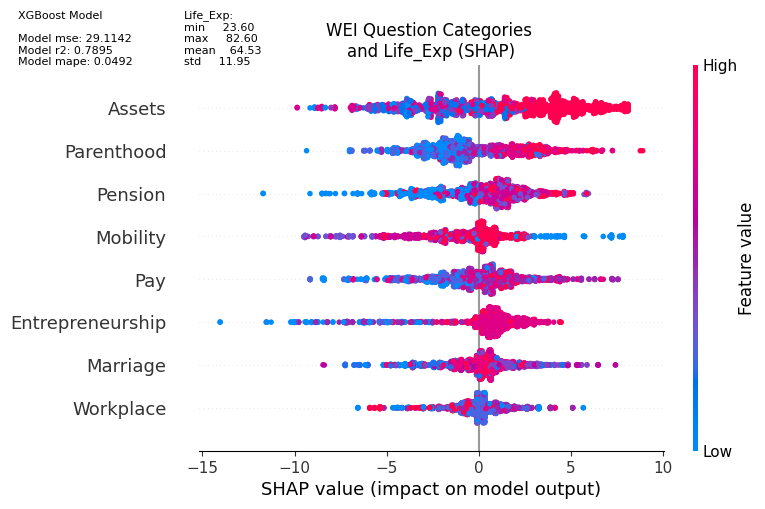

In [263]:
#organize data for modeling
target = 'Life_Exp'


X = pivot_df[[ 
 # 'Country_Name',
 # 'Year',
 # 'Life_Exp',
 # 'Population',
 # 'GDP_Per_Cap',
 # 'GDP_Growth',
 'Assets',
 'Entrepreneurship',
 'Marriage',
 'Mobility',
 'Parenthood',
 'Pay',
 'Pension',
 'Workplace'
]]

y = pivot_df[target]


#split into training and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=59)


#GridSearch   #####################################################################################################################
model = xgb.XGBRegressor()

#implement gridsearch parameters
param_grid = {
    'n_estimators':[100],
    'learning_rate':[.5],
    'max_depth':[15],
    'alpha':[.15],
    'early_stopping_rounds':[10, 12]
}

#instantiate gridsearch cv
grid_search = GridSearchCV(estimator=model,
                           param_grid=param_grid,
                           scoring='neg_mean_squared_error',
                           cv=5,
                           n_jobs=-1 #setting n_jobs to -1 uses all processors
                           )


#implement gridsearch
grid_search.fit(X_train, y_train,
                eval_set=[(X_test, y_test)],
                verbose=False
               )

#print results of best_params_
print(f'The best parameters found by GridSearch are:\n{grid_search.best_params_}')


#define the best model with best_params_ ########################################################################################
best_model = grid_search.best_estimator_

#predictions
y_pred = best_model.predict(X_test)

#scoring using y_test set and predictions
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)

print(f'Best model mse: {mse:.4f}\n\
Best model r2: {r2:.4f}\n\
Best model mape: {mape:.4f}')

#SHAP for feature importance and model interpretation
explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, show=False)

plt.title(f'WEI Question Categories \nand {target} (SHAP)')
plt.text(-25,8, f'XGBoost Model\n\nModel mse: {mse:.4f}\nModel r2: {r2:.4f}\nModel mape: {mape:.4f}', fontdict={'fontsize':8})
plt.text(-16,8, f"{target}:\n{df[target].agg(['min', 'max', 'mean', 'std']).round(2).to_string(index=True)}", fontdict={'fontsize':8})

shap_qc_lifeexp = plt.gcf()

# Other Models

The best parameters found by GridSearch are:
{'alpha': 0.15, 'early_stopping_rounds': 10, 'learning_rate': 0.5, 'max_depth': 15, 'n_estimators': 100}
Best model mse: 41559690.6788
Best model r2: 0.7079
Best model mape: 0.8443


[11:32:40] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
[11:32:41] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


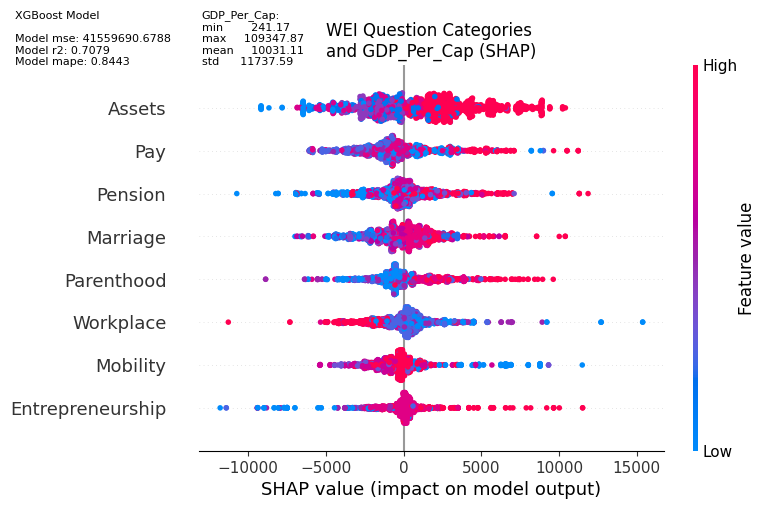

In [264]:
#organize data for modeling
target = 'GDP_Per_Cap'


X = pivot_df[[ 
 # 'Country_Name',
 # 'Year',
 # 'Life_Exp',
 # 'Population',
 # 'GDP_Per_Cap',
 # 'GDP_Growth',
 'Assets',
 'Entrepreneurship',
 'Marriage',
 'Mobility',
 'Parenthood',
 'Pay',
 'Pension',
 'Workplace'
]]

y = pivot_df[target]


#split into training and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=59)


#GridSearch   ####################################################### GRIDSEARCH ################################################
model = xgb.XGBRegressor()

#implement gridsearch parameters
param_grid = {
    'n_estimators':[100],
    'learning_rate':[.5],
    'max_depth':[15],
    'alpha':[.15],
    'early_stopping_rounds':[10, 12]
}

#instantiate gridsearch cv
grid_search = GridSearchCV(estimator=model,
                           param_grid=param_grid,
                           scoring='neg_mean_squared_error',
                           cv=5,
                           n_jobs=-1 #setting n_jobs to -1 uses all processors
                           )


#implement gridsearch
grid_search.fit(X_train, y_train,
                eval_set=[(X_test, y_test)],
                verbose=False
               )

#print results of best_params_
print(f'The best parameters found by GridSearch are:\n{grid_search.best_params_}')


#define the best model with best_params_ ################################# EVALUATE MODEL ############################################
best_model = grid_search.best_estimator_

#predictions
y_pred = best_model.predict(X_test)

#scoring using y_test set and predictions
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)

print(f'Best model mse: {mse:.4f}\n\
Best model r2: {r2:.4f}\n\
Best model mape: {mape:.4f}')

#SHAP for feature importance and model interpretation ############################### SHAP VALUES ###################################  
explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, show=False)

plt.title(f'WEI Question Categories \nand {target} (SHAP)')
plt.text(-25000,8, f'XGBoost Model\n\nModel mse: {mse:.4f}\nModel r2: {r2:.4f}\nModel mape: {mape:.4f}', fontdict={'fontsize':8})
plt.text(-13000,8, f"{target}:\n{df[target].agg(['min', 'max', 'mean', 'std']).round(2).to_string(index=True)}", fontdict={'fontsize':8})

shap_qc_gdp_percap = plt.gcf()

# Group by Questions

In [265]:
df_q = df.groupby(['Country_Name', 'Year', 'Question', 
                   'Life_Exp', 'Population', 'GDP_Per_Cap', 
                   'GDP_Growth'])['Index_Score'].agg('mean').reset_index()

pivot_q = df_q.pivot_table(index=['Country_Name', 'Year', 'Life_Exp', 'Population', 'GDP_Growth', 'GDP_Per_Cap'],
                           columns='Question',
                           values='Index_Score',
                           aggfunc='mean'
                          ).reset_index()
pivot_q

Question,Country_Name,Year,Life_Exp,Population,GDP_Growth,GDP_Per_Cap,Are periods of absence from work due to childcare accounted for in pension benefits?,Are the ages at which men and women can retire with full pension benefits equal?,Are the ages at which men and women can retire with partial pension benefits equal?,Are there criminal penalties or civil remedies for sexual harassment in employment?,...,Does the law prohibit discrimination in employment based on gender?,Does the law provide for the valuation of nonmonetary contributions?,Is dismissal of pregnant workers prohibited?,Is paid leave of at least 14 weeks available to mothers?,Is the mandatory retirement age for men and women equal?,Is there legislation on sexual harassment in employment?,Is there legislation specifically addressing domestic violence?,Is there no legal provision that requires a married woman to obey her husband?,Is there paid leave available to fathers?,Is there paid parental leave?
0,Afghanistan,1971,36.08800,1.307946e+07,3.918294,739.981106,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
1,Afghanistan,1972,36.08800,1.307946e+07,3.918294,739.981106,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
2,Afghanistan,1973,36.08800,1.307946e+07,3.918294,739.981106,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
3,Afghanistan,1974,36.08800,1.307946e+07,3.918294,739.981106,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
4,Afghanistan,1975,36.08800,1.307946e+07,3.918294,739.981106,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
5,Afghanistan,1976,36.08800,1.307946e+07,3.918294,739.981106,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
6,Afghanistan,1977,38.43800,1.488037e+07,3.918294,786.113360,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
7,Afghanistan,1978,38.43800,1.488037e+07,3.918294,786.113360,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
8,Afghanistan,1979,38.43800,1.488037e+07,3.918294,786.113360,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0
9,Afghanistan,1980,38.43800,1.488037e+07,3.918294,786.113360,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0


In [266]:
pivot_q.columns.tolist()

['Country_Name',
 'Year',
 'Life_Exp',
 'Population',
 'GDP_Growth',
 'GDP_Per_Cap',
 'Are periods of absence from work due to childcare accounted for in pension benefits?',
 'Are the ages at which men and women can retire with full pension benefits equal?',
 'Are the ages at which men and women can retire with partial pension benefits equal?',
 'Are there criminal penalties or civil remedies for sexual harassment in employment?',
 'Are women able to work in the same industries as men?',
 'Can a woman apply for a passport in the same way as a man?',
 'Can a woman be "head of household" or "head of family" in the same way as a man?',
 'Can a woman choose where to live in the same way as a man?',
 'Can a woman get a job in the same way as a man?',
 'Can a woman obtain a judgment of divorce in the same way as a man?',
 'Can a woman open a bank account in the same way as a man?',
 'Can a woman register a business in the same way as a man?',
 'Can a woman sign a contract in the same way as 

The best parameters found by GridSearch are:
{'alpha': 0.15, 'early_stopping_rounds': 10, 'learning_rate': 0.1, 'max_depth': 8, 'n_estimators': 200}
Best model mse: 25194469.1340
Best model r2: 0.8229
Best model mape: 0.6263


[11:32:58] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
[11:33:00] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


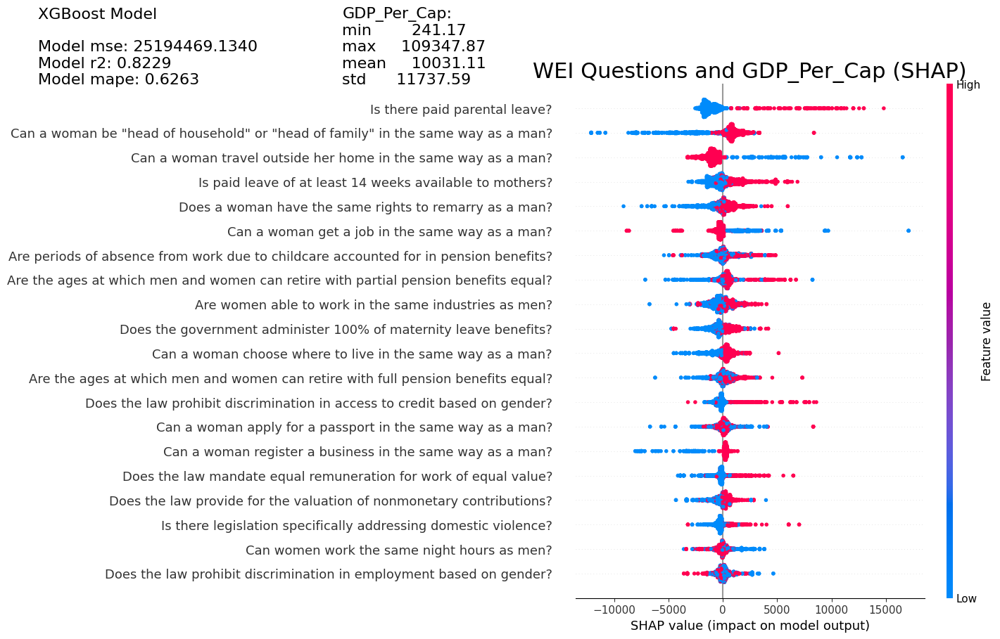

In [267]:
#organize data for modeling
target = 'GDP_Per_Cap'


X = pivot_q[[ 
 # 'Country_Name',
 # 'Year',
 # 'Life_Exp',
 # 'Population',
 # 'GDP_Growth',
 # 'GDP_Per_Cap',
 'Are periods of absence from work due to childcare accounted for in pension benefits?',
 'Are the ages at which men and women can retire with full pension benefits equal?',
 'Are the ages at which men and women can retire with partial pension benefits equal?',
 'Are there criminal penalties or civil remedies for sexual harassment in employment?',
 'Are women able to work in the same industries as men?',
 'Can a woman apply for a passport in the same way as a man?',
 'Can a woman be "head of household" or "head of family" in the same way as a man?',
 'Can a woman choose where to live in the same way as a man?',
 'Can a woman get a job in the same way as a man?',
 'Can a woman obtain a judgment of divorce in the same way as a man?',
 'Can a woman open a bank account in the same way as a man?',
 'Can a woman register a business in the same way as a man?',
 'Can a woman sign a contract in the same way as a man?',
 'Can a woman travel outside her home in the same way as a man?',
 'Can a woman travel outside the country in the same way as a man?',
 'Can women work in jobs deemed dangerous in the same way as men?',
 'Can women work the same night hours as men?',
 'Do female and male surviving spouses have equal rights to inherit assets?',
 'Do men and women have equal ownership rights to immovable property?',
 'Do sons and daughters have equal rights to inherit assets from their parents?',
 'Does a woman have the same rights to remarry as a man?',
 'Does the government administer 100% of maternity leave benefits?',
 'Does the law grant spouses equal administrative authority over assets during marriage?',
 'Does the law mandate equal remuneration for work of equal value?',
 'Does the law prohibit discrimination in access to credit based on gender?',
 'Does the law prohibit discrimination in employment based on gender?',
 'Does the law provide for the valuation of nonmonetary contributions?',
 'Is dismissal of pregnant workers prohibited?',
 'Is paid leave of at least 14 weeks available to mothers?',
 'Is the mandatory retirement age for men and women equal?',
 'Is there legislation on sexual harassment in employment?',
 'Is there legislation specifically addressing domestic violence?',
 'Is there no legal provision that requires a married woman to obey her husband?',
 'Is there paid leave available to fathers?',
 'Is there paid parental leave?'
]]

y = pivot_q[target]


#split into training and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=59)


#GridSearch   ####################################################### GRIDSEARCH ################################################
model = xgb.XGBRegressor()

#implement gridsearch parameters
param_grid = {
    'n_estimators':[200],
    'learning_rate':[.1],
    'max_depth':[ 8],
    'alpha':[.15],
    'early_stopping_rounds':[10]
}

#instantiate gridsearch cv
grid_search = GridSearchCV(estimator=model,
                           param_grid=param_grid,
                           scoring='neg_mean_squared_error',
                           cv=5,
                           n_jobs=-1 #setting n_jobs to -1 uses all processors
                           )


#implement gridsearch
grid_search.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=False)

#print results of best_params_
print(f'The best parameters found by GridSearch are:\n{grid_search.best_params_}')


#define the best model with best_params_ ################################# EVALUATE MODEL ############################################
best_model = grid_search.best_estimator_

#predictions
y_pred = best_model.predict(X_test)

#scoring using y_test set and predictions
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)

print(f'Best model mse: {mse:.4f}\n\
Best model r2: {r2:.4f}\n\
Best model mape: {mape:.4f}')

#SHAP for feature importance and model interpretation ############################### SHAP VALUES ###################################  
explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, show=False)

plt.title(f'WEI Questions and {target} (SHAP)', fontdict={'fontsize':22})
plt.text(-63000,20, f'XGBoost Model\n\nModel mse: {mse:.4f}\nModel r2: {r2:.4f}\nModel mape: {mape:.4f}', fontdict={'fontsize':16})
plt.text(-35000,20, f"{target}:\n{df[target].agg(['min', 'max', 'mean', 'std']).round(2).to_string(index=True)}", fontdict={'fontsize':16})

shap_q_gdp_percap = plt.gcf()

The best parameters found by GridSearch are:
{'alpha': 0.15, 'early_stopping_rounds': 10, 'learning_rate': 0.1, 'max_depth': 8, 'n_estimators': 200}
Best model mse: 16.5683
Best model r2: 0.8802
Best model mape: 0.0334


[11:33:15] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
[11:33:16] WARNING: /Users/runner/work/xgboost/xgboost/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


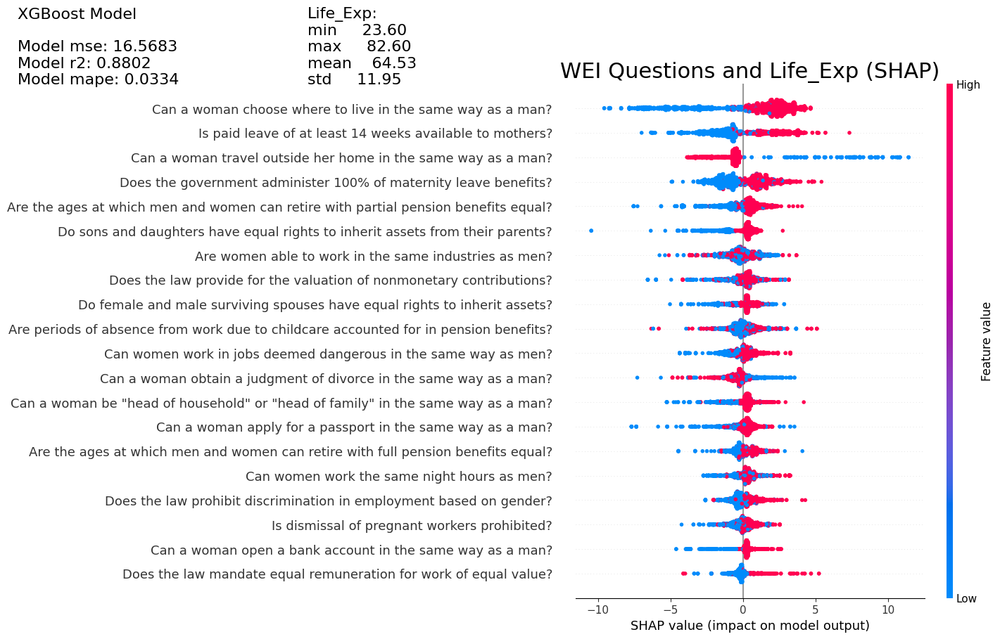

In [268]:
#organize data for modeling
target = 'Life_Exp'


X = pivot_q[[ 
 # 'Country_Name',
 # 'Year',
 # 'Life_Exp',
 # 'Population',
 # 'GDP_Growth',
 # 'GDP_Per_Cap',
 'Are periods of absence from work due to childcare accounted for in pension benefits?',
 'Are the ages at which men and women can retire with full pension benefits equal?',
 'Are the ages at which men and women can retire with partial pension benefits equal?',
 'Are there criminal penalties or civil remedies for sexual harassment in employment?',
 'Are women able to work in the same industries as men?',
 'Can a woman apply for a passport in the same way as a man?',
 'Can a woman be "head of household" or "head of family" in the same way as a man?',
 'Can a woman choose where to live in the same way as a man?',
 'Can a woman get a job in the same way as a man?',
 'Can a woman obtain a judgment of divorce in the same way as a man?',
 'Can a woman open a bank account in the same way as a man?',
 'Can a woman register a business in the same way as a man?',
 'Can a woman sign a contract in the same way as a man?',
 'Can a woman travel outside her home in the same way as a man?',
 'Can a woman travel outside the country in the same way as a man?',
 'Can women work in jobs deemed dangerous in the same way as men?',
 'Can women work the same night hours as men?',
 'Do female and male surviving spouses have equal rights to inherit assets?',
 'Do men and women have equal ownership rights to immovable property?',
 'Do sons and daughters have equal rights to inherit assets from their parents?',
 'Does a woman have the same rights to remarry as a man?',
 'Does the government administer 100% of maternity leave benefits?',
 'Does the law grant spouses equal administrative authority over assets during marriage?',
 'Does the law mandate equal remuneration for work of equal value?',
 'Does the law prohibit discrimination in access to credit based on gender?',
 'Does the law prohibit discrimination in employment based on gender?',
 'Does the law provide for the valuation of nonmonetary contributions?',
 'Is dismissal of pregnant workers prohibited?',
 'Is paid leave of at least 14 weeks available to mothers?',
 'Is the mandatory retirement age for men and women equal?',
 'Is there legislation on sexual harassment in employment?',
 'Is there legislation specifically addressing domestic violence?',
 'Is there no legal provision that requires a married woman to obey her husband?',
 'Is there paid leave available to fathers?',
 'Is there paid parental leave?'
]]

y = pivot_q[target]


#split into training and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=59)


#GridSearch   ####################################################### GRIDSEARCH ################################################
model = xgb.XGBRegressor()

#implement gridsearch parameters
param_grid = {
    'n_estimators':[200],
    'learning_rate':[.1],
    'max_depth':[ 8],
    'alpha':[.15],
    'early_stopping_rounds':[10]
}

#instantiate gridsearch cv
grid_search = GridSearchCV(estimator=model,
                           param_grid=param_grid,
                           scoring='neg_mean_squared_error',
                           cv=5,
                           n_jobs=-1 #setting n_jobs to -1 uses all processors
                           )


#implement gridsearch
grid_search.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=False)

#print results of best_params_
print(f'The best parameters found by GridSearch are:\n{grid_search.best_params_}')


#define the best model with best_params_ ################################# EVALUATE MODEL ############################################
best_model = grid_search.best_estimator_

#predictions
y_pred = best_model.predict(X_test)

#scoring using y_test set and predictions
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)

print(f'Best model mse: {mse:.4f}\n\
Best model r2: {r2:.4f}\n\
Best model mape: {mape:.4f}')

#SHAP for feature importance and model interpretation ############################### SHAP VALUES ################################### 
plt.figure(figsize=(12, 8))  

explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, show=False)

plt.title(f'WEI Questions and {target} (SHAP)', fontdict={'fontsize':22})
plt.text(-50,20, f'XGBoost Model\n\nModel mse: {mse:.4f}\nModel r2: {r2:.4f}\nModel mape: {mape:.4f}', fontdict={'fontsize':16})
plt.text(-30,20, f"{target}:\n{df[target].agg(['min', 'max', 'mean', 'std']).round(2).to_string(index=True)}", fontdict={'fontsize':16})


shap_q_lifeexp = plt.gcf()

In [269]:
#export SHAP charts
# shap_qc_lifeexp.figure.savefig('/Users/amritambe/Desktop/WEI_Shap_qc_Lifeexp.png')
# shap_qc_gdp_percap.figure.savefig('/Users/amritambe/Desktop/WEI_Shap_qc_Gdppercap.png')
# shap_q_lifeexp.figure.savefig('/Users/amritambe/Desktop/WEI_Shap_q_Lifeexp.png')
# shap_q_gdp_percap.figure.savefig('/Users/amritambe/Desktop/WEI_Shap_q_Gdppercap.png')